# Origin of Bistability in the _lac_ Operon
## Jocksan Villavicencio Villavicencio

Multistability is an emergent dynamic property that has been invoked to explain multiple coexisting biological
states. In the article, they investigate the origin of bistability in the inducible _lac_ operon, a classic example of bistability.

Multistability corresponds to a true switch between alternate and coexisting steady states, and so allows a graded signal to be turned into a discontinuos evolution of the system, along several different possible pathways. Multistability has certain unique properties that play an essential role in the dynamics of living cells and organisms.

Based on the examination on the dynamics of the _lac_ operon, researchers address the following questions:

> "How did multistability arise within the context of gene regulatory networks?"

> "What evolutionary advantages do bistable regulatory networks have when compared with monostable ones?" 
  
They develop a mathematical model for the _lac_ operon, below is shown the full set of equations for the model, which consists of three differential equations that describe the temporal evolution of mRNA ($M$), _lacZ_ polypeptide ($E$), and internal lactose ($L$) concentrations (first three equation in the following table).

| Equation | Description | Eq. No. |
|----------|-------------|---------|
|$\dot{M} = Dk_\mathrm{M}\mathcal{P}_\mathrm{D}(Ge)\mathcal{P}_\mathrm{R}(A) - \gamma_\mathrm{M}M$ | mRNA concentration | $(1)$ |
|$\dot{E} = k_\mathrm{E}M - \gamma_\mathrm{E}E$ | _lacZ_ polypeptide concentration | $(2)$ |
|$\dot{L} = k_\mathrm{L}\beta_\mathrm{L}(Le)\beta_\mathrm{G}(Ge)Q - 2\phi_\mathrm{M}\mathcal{M}(L)B - \gamma_\mathrm{L}L$ | Lactose concentration | $(3)$ |
|$A = L$ | Intracellular allolactose concentration| $(4)$ |
|$Q = E$ | Permease concentration| $(5)$ |
|$B = E/4$ | $\beta$-galactosidase concentration | $(6)$ |
|$\mathcal{P}_\mathrm{D}(Ge) = \frac{p_\mathrm{p}(1 + p_\mathrm{c}(Ge)(k_\mathrm{pc} - 1))}{1 + p_\mathrm{p}p_\mathrm{c}(Ge)(k_\mathrm{pc}-1)}$ | Negative effect of external glucose on the initiation rate of transcription (via catabolite repression) | $(7)$ |
|$p_\mathrm{c}(Ge) = \frac{K_\mathrm{G}^{n_h}}{K_\mathrm{G}^{n_h} + Ge_\mathrm{G}^{n_h}}$ | Internal auxiliary variable | $(8)$ |
|$\mathcal{P}_\mathrm{R}(A) = \frac{1}{1 + \rho(A) + \frac{\xi_{123}\rho(A)}{(1+\xi_2\rho(A))(1 + \xi_3\rho(A))}}$ | Probability that the lactose promoter is not repressed | $(9)$ |
|$\rho(A) = \rho_{\mathrm{max}} \left( \frac{K_\mathrm{A}}{K_\mathrm{A} + A}\right)^4$ | Internal auxiliary variable | $(10)$ |
|$\beta_\mathrm{L}(Le) = \frac{Le}{\kappa_\mathrm{L} + Le}$ | Positive effect of external lactose on its uptake rate | $(11)$ |
|$\beta_\mathrm{G}(Ge) = 1 - \phi_\mathrm{G}\frac{Ge}{\kappa_\mathrm{G} + Ge}$ | Negative effect of external glucose on lactose uptake (inducer exclusion) | $(12)$ |
|$\mathcal{M}(L) = \frac{L}{\kappa_\mathrm{M} + L}$ | $2\phi_\mathrm{M}\mathcal{M}$ is the rate of lactose metabolism per $\beta$-galactosidase | $(13)$ |


The parameters used can be found in the next table, the estimation of each parameter can be read in the appendix of the original article, although many of them come from the literature.


| <div style="width:230px">Parameters</div> | |
|-----------|-|
| $\mu \approx 0.02 \;\mathrm{min}^{-1}$ | $K_\mathrm{G} \approx 2.6 \;\mu\mathrm{M}$ |
| $D \approx 2 \;\mathrm{mpb}$ | $n_\mathrm{h} \approx 1.3$ |
| $k_\mathrm{M} \approx 0.18 \;\mathrm{min}^{-1}$ | $\xi_2 \approx 0.05$ |
| $k_\mathrm{E} \approx 18.8 \;\mathrm{min}^{-1}$ | $\xi_3 \approx 0.01$ |
| $k_\mathrm{L} \approx 6.0 \times 10^4 \;\mathrm{min}^{-1}$ | $\xi_{123} \approx 163$ |
| $\gamma_\mathrm{M} \approx 0.48 \;\mathrm{min}^{-1}$ | $\rho_\mathrm{max} \approx 1.3$ |
| $\gamma_\mathrm{E} \approx 0.03 \;\mathrm{min}^{-1}$ | $K_\mathrm{A} \approx 2.92 \times 10^6\;\mathrm{mpb}$ |
| $\gamma_\mathrm{L} \approx 0.02 \;\mathrm{min}^{-1}$ | $\kappa_\mathrm{L} \approx 680 \;\mu\mathrm{M}$ |
| $k_\mathrm{pc} \approx 30$ | $\phi_\mathrm{G} \approx 0.35$ |
| $p_\mathrm{p} \approx 0.127$ | $\kappa_\mathrm{G} \approx 1.0 \;\mu\mathrm{M}$ |
| $\phi_\mathrm{M} \approx \; \in [0, 4.0 \times 10^4] \;\mathrm{min}^{-1}$  | $\kappa_\mathrm{M} \approx 7.0 \times 10^5\;\mathrm{mpb}$ |


In [1]:
using DifferentialEquations
using Distributions
using LaTeXStrings
using StatsBase
using Random
using Plots
using Roots

<div class="alert alert-block alert-success">

> **Lets have a look at the model with the specified parameters. Only for the following graph, I dont consider any stochasticity.**

</div>

In [2]:
function model!(du, u, p, t)
    M, E, L = u   # mRNA, Polypeptide, Lactose
    #μ, D, kₘ, kₑ, kₗ, γₘ, γₑ, γₗ, kpc, pₚ, Φₘ, K_G, nₕ, ξ₂, ξ₃, ξ₁₂₃, ρₘₐₓ, Kₐ, κₗ, Φg, κg, κₘ = p

    #-------------
    A = L
    Q = E
    B = E/4
    #-------------
    p_c(Ge) = p.K_G^p.nₕ / (p.K_G^p.nₕ + Ge^p.nₕ)
    P_D(Ge) = (p.pₚ*(1 + p_c(Ge) * (p.kpc - 1))) / (1 + p.pₚ * p_c(Ge) * (p.kpc - 1))
    ρ(A) = p.ρₘₐₓ * (p.Kₐ / (p.Kₐ + A))^4
    P_R(A) = 1 / (1 + ρ(A) + ((p.ξ₁₂₃ * ρ(A)) / ((1 + p.ξ₂ * ρ(A)) * (1 + p.ξ₃ * ρ(A)))))
    β_L(Le) = Le / (p.κₗ + Le)
    β_G(Ge) = 1 - p.Φg * Ge / (p.κg + Ge)
    M_(L) = L / (p.κₘ + L)
    #-------------

    du[1] = dM = p.D * p.kₘ * P_D(Ge) * P_R(A) - p.γₘ * M
    du[2] = dE = p.kₑ * M - p.γₑ * E
    du[3] = dL = p.kₗ * β_L(Le) * β_G(Ge) * Q - 2 * p.Φₘ * M_(L) * B - p.γₗ * L
end;

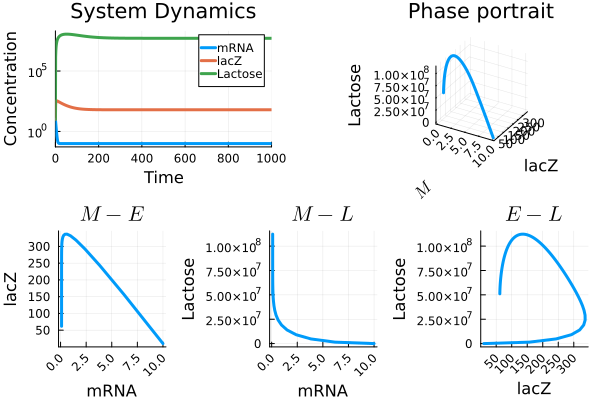

In [15]:
Le = 500
Ge = 400

p = (μ = 0.02, D = 2, kₘ = 0.18, kₑ = 18.8, kₗ = 6e4, γₘ = 0.48, γₑ = 0.03, γₗ = 0.02, kpc = 30, 
    pₚ = 0.127, Φₘ = 0, K_G = 2.6, nₕ = 1.3, ξ₂ = 0.05, ξ₃ = 0.01, ξ₁₂₃ = 163, ρₘₐₓ = 1.3, 
    Kₐ = 2.92e6, κₗ = 680, Φg = 0.35, κg = 1, κₘ = 7e5)

u₀ = [10, 10, 10]  # M, E, L
tspan = (0.0, 1000)

prob = ODEProblem(model!, u₀, tspan, p)
sol = solve(prob)

xyzt = plot(sol, yaxis=:log10, lw = 3, xaxis = "Time", ylabel = "Concentration", label = ["mRNA" "lacZ" "Lactose"], title = "System Dynamics")
xyz = plot(sol, idxs = (1,2,3), lw = 3, xaxis = L"M", ylabel = "lacZ", zlabel = "Lactose", 
    label = "", xrotation = 45, title = "Phase portrait")
xy = plot(sol, idxs = (1,2), lw = 3, xaxis = "mRNA", ylabel = "lacZ", 
    label = "", xrotation = 45, title = L"M - E")
xz = plot(sol, idxs = (1,3), lw = 3, xaxis = "mRNA", ylabel = "Lactose", 
    label = "", xrotation = 45, title = L"M - L")
yz = plot(sol, idxs = (2,3), lw = 3, xaxis = "lacZ", ylabel = "Lactose", 
    label = "", xrotation = 45, title = L"E - L")

plot(plot(xyzt, xyz), plot(xy, xz, yz, layout = (1, 3)), layout = (2, 1))

<div class="alert alert-block alert-info">

> **Actually, they did stochastic simulations of the model via Gillespie's Tau Leaping algorithm. So lets implement it. It will be of help for the last figure**

</div>

In [52]:
###### Fix model parameters ######
N_M0, N_E0, N_L0 = u₀     # Initial number of molecules
#-------------
p_c(Ge) = p.K_G^p.nₕ / (p.K_G^p.nₕ + Ge^p.nₕ)
P_D(Ge) = (p.pₚ*(1 + p_c(Ge) * (p.kpc - 1))) / (1 + p.pₚ * p_c(Ge) * (p.kpc - 1))
ρ(A) = p.ρₘₐₓ * (p.Kₐ / (p.Kₐ + A))^4
P_R(A) = 1 / (1 + ρ(A) + ((p.ξ₁₂₃ * ρ(A)) / ((1 + p.ξ₂ * ρ(A)) * (1 + p.ξ₃ * ρ(A)))))
β_L(Le) = Le / (p.κₗ + Le)
β_G(Ge) = 1 - p.Φg * Ge / (p.κg + Ge)
M_(L) = L / (p.κₘ + L)
#-------------

leap = 0.5 # Size of leaping steps

steps = 2000    # Number of leaps per trajectory
cycles = 50  # Number of trajectories iterated over

# Set up holder arrays
T = collect(0:steps)*leap
N_M = zeros(Int64, cycles, steps+1)
N_E = zeros(Int64, cycles, steps+1)
N_L = zeros(Int64, cycles, steps+1)

# Store initial conditions
N_M[:,1] .= N_M0
N_E[:,1] .= N_E0
N_L[:,1] .= N_L0

###### Main Code Loop ######
for i ∈ 1:cycles
    for j ∈ 1:steps
        # Calculate updated reaction rates
        A = N_L[i,j]
        Q = N_E[i,j]
        B = N_E[i,j]/4

        R1 = p.D * p.kₘ * P_D(Ge) * P_R(A)
        R2 = p.γₘ * N_M[i,j]
        R3 = p.kₑ * N_M[i,j]
        R4 = p.γₑ * N_E[i,j]
        R5 = p.kₗ * β_L(Le) * β_G(Ge) * Q
        R6 = 2 * p.Φₘ * M_(N_L[i,j]) * B
        R7 = p.γₗ * N_L[i,j]        
        
        # Calculate number of reactions by type
        u1 = rand()
        u2 = rand()
        u3 = rand()
        u4 = rand()
        u5 = rand()
        u6 = rand()
        u7 = rand()
        
        N1 = quantile(Poisson(R1*leap), u1)
        N2 = quantile(Poisson(R2*leap), u2)
        N3 = quantile(Poisson(R3*leap), u3)
        N4 = quantile(Poisson(R4*leap), u4)
        N5 = quantile(Poisson(R5*leap), u5)
        N6 = quantile(Poisson(R6*leap), u6)
        N7 = quantile(Poisson(R7*leap), u7)
        
        # Apply limits to prevent negative population
        Limit2 = N_M[i,j]
        Limit4 = N_E[i,j]
        Limit6 = N_L[i,j]
        Limit7 = N_L[i,j]
        
        N2 = min(N2, Limit2)
        N4 = min(N4, Limit4)
        N6 = min(N6, Limit6)
        N7 = min(N7, Limit7)
        
        # Update populations
        N_M[i,j+1] = N_M[i,j] + N1 - N2
        N_E[i,j+1] = N_E[i,j] + N3 - N4
        N_L[i,j+1] = N_L[i,j] + N5 - N6 - N7
    end
end

<div class="alert alert-block alert-success">

> **Here I show almost the same dynamic as the ODE system (averaged trajectories)**

</div>

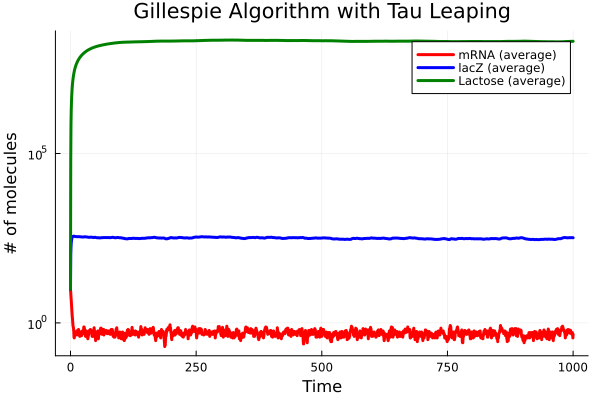

In [53]:
# Calculate average arrays
N_M_ave = mean(N_M, dims=1)[:]
N_E_ave = mean(N_E, dims=1)[:]
N_L_ave = mean(N_L, dims=1)[:]

###### Plot Trajectories ######
plot(T, N_M_ave, yaxis=:log10, color=:red, lw = 3, label="mRNA (average)")
plot!(T, N_E_ave, yaxis=:log10, color=:blue, lw = 3, label="lacZ (average)")
plot!(T, N_L_ave, yaxis=:log10, color=:green, lw = 3, label="Lactose (average)")
xlabel!("Time")
ylabel!("# of molecules")
title!("Gillespie Algorithm with Tau Leaping")

<div class="alert alert-block alert-success">

> **Observe multiple realizations of the system...**

</div>

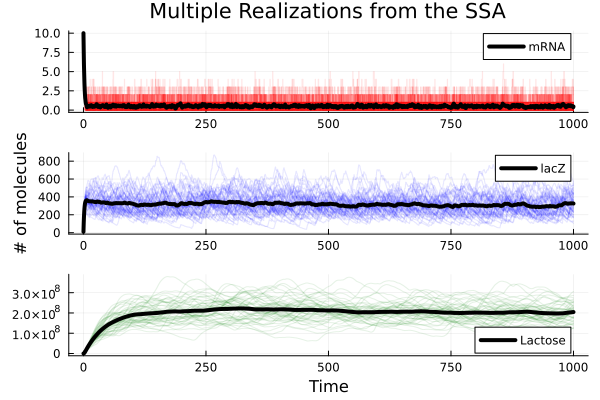

In [54]:
p1 = plot()
for i ∈ 1:cycles
    plot!(T[:], N_M[i,:], color=:red, linealpha=0.1, label = false, linetype = :steppost)
end
plot!(T, N_M_ave, color=:black, lw = 4, label = "mRNA")
plot!(xlabel = "", ylabel = "", title = "Multiple Realizations from the SSA")

p2 = plot()
for i ∈ 1:cycles
    plot!(T[:], N_E[i,:], color=:blue, linealpha=0.1, label = false, linetype = :steppost)
end
plot!(T, N_E_ave, color=:black, lw = 4, label = "lacZ")
plot!(xlabel = "", ylabel = "# of molecules")

p3 = plot()
for i ∈ 1:cycles
    plot!(T[:], N_L[i,:], color=:green, linealpha=0.1, label = false, linetype = :steppost)
end
plot!(T, N_L_ave, color=:black, lw = 4, label = "Lactose")
plot!(xlabel = "Time", ylabel = "")

plot(p1, p2, p3, layout = (3, 1))

## Stability

The model's steady states and the stability depends on the values of $Le$ and $Ge$, there can be up to three steady states. For very low values of $Le$ there is a single stable steady state that corresponds to the uninduced state. As $Le$ increases, two more steady states appear via a saddle-node bifurcation. The two new fixed points are either stable (the induced state), while the other is a saddle node.

If we keep increasing $Le$, the saddle-node bifurcation and the original steady-state approach until they eventually collide and are annihilated, then, only the induced stable steady state survives.

As can be readen in the appendix, we can look for the steady-state values $L^*$ if we look for the roots of the equation $\mathcal{S}(L^*) = 0$, with $\mathcal{S}(L^*)$ defined as follows:
$$\mathcal{S}(L^*) := \frac{D k_{\mathrm{M}} k_{\mathrm{E}} k_{\mathrm{L}}}{\gamma_{\mathrm{M}} \gamma_{\mathrm{E}} \gamma_{\mathrm{L}}}\left[\beta_{\mathrm{L}} \beta_{\mathrm{G}}-\frac{\phi_{\mathrm{M}}}{2 k_{\mathrm{L}}} \mathcal{M}\left(L^*\right)\right] \mathcal{P}_{\mathrm{D}} \mathcal{P}_{\mathrm{R}}\left(L^*\right)-L^*$$

We can also calculate if a given steady-state is locally stable if the derivative:
$$\frac{d \mathcal{S}\left(L^*\right)}{d L^*} = \frac{Q_3-P(0)}{\gamma_{\mathrm{M}} \gamma_{\mathrm{E}} \gamma_{\mathrm{L}}}$$

is strictly negative. With $Q_3$ and $P(s)$ defined as follows:

$$
\begin{aligned}
P(s) & :=\left(s+\gamma_{\mathrm{M}}\right)\left(s+\gamma_{\mathrm{E}}\right)\left(s+\gamma_3\right) \\
Q_3 & :=D k_{\mathrm{M}} k_{\mathrm{E}} k_{\mathrm{L}}\left[\beta_{\mathrm{L}} \beta_E-\frac{\phi_{\mathrm{M}}}{2 k_{\mathrm{L}}} \mathcal{M}\left(L^*\right)\right] \mathcal{P}_{\mathrm{D}} \mathcal{P}_{\mathrm{R}}^{\prime}\left(L^*\right)
\end{aligned}
$$

<div class="alert alert-block alert-success">

> **Below I show three different conditions where I vary $Le$, to notice the emergence of the two new fixed points, and the eventual vanish of two of them as I increase $Le$ again. The red lines in the plot show the roots of $\mathcal{S}(L^*)$. If you pay attention, I also print the derivative $\frac{d \mathcal{S}\left(L^*\right)}{d L^*}$ evaluated to each root, respectively.**
> 
> **Actually, I print the pair $(L^*, \frac{d \mathcal{S}\left(L^*\right)}{d L^*})$**

</div>

In [7]:
steady(L) = ((p.D *  p.kₘ * p.kₑ * p.kₗ )/(p.γₘ * p.γₑ * p.γₗ)) * (β_L(Le) * β_G(Ge) - (p.Φₘ/(2*p.κₗ)) * M_(L)) * P_D(Ge) * P_R(L) - L
Q₃(L) = p.D *  p.kₘ * p.kₑ * p.kₗ * (β_L(Le) * β_G(Ge) - (p.Φₘ/(2*p.κₗ)) * M_(L)) * P_D(Ge) * P_R(L)
stable(L) = (Q₃(L) / p.γₘ * p.γₑ * p.γₗ) - 1 ;

[(8825.706363635074, -0.9968227457090914)]
[(334483.23742448085, -0.8795860345271869), (2.7070335690911533e6, -0.025467915127184937), (4.4183685047085956e7, 14.906126616950944)]
[(8.231863892487383e7, 28.634710012954578)]


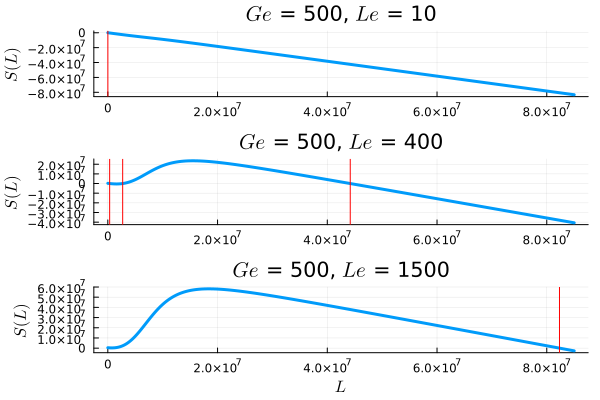

In [8]:
Ge = 500
Le = 10
p1 = plot(0:1e4:8.5e7, [steady(L) for L in 0:1e4:8.5e7], label = false, xlabel = "", ylabel = L"S(L)", lw = 3)
title!(L"$Ge$ = %$Ge, $Le$ = %$Le")
roots = find_zeros(steady, 0, 1e8)
plot!(roots, linetype = :vline, color = :red, label = false)
println([(l, stable(l)) for l in roots])

Le = 400
p2 = plot(0:1e4:8.5e7, [steady(L) for L in 0:1e4:8.5e7], label = false, xlabel = "", ylabel = L"S(L)", lw = 3)
title!(L"$Ge$ = %$Ge, $Le$ = %$Le")
roots = find_zeros(steady, 0, 1e8)
plot!(roots, linetype = :vline, color = :red, label = false)
println([(l, stable(l)) for l in roots])

Le = 1500
p3 = plot(0:1e4:8.5e7, [steady(L) for L in 0:1e4:8.5e7], label = false, xlabel = L"$L$", ylabel = L"S(L)", lw = 3)
title!(L"$Ge$ = %$Ge, $Le$ = %$Le")
roots = find_zeros(steady, 0, 1e8)
plot!(roots, linetype = :vline, color = :red, label = false)
println([(l, stable(l)) for l in roots])

plot(p1, p2, p3, layout = (3, 1))

With this information in hand, it is now possible to attemp a reconstruction of the bifurcation diagrams.

<div class="alert alert-block alert-warning">

> **I'll only show two bifurcation diagrams, since the approach I decided to use isn't the best one in terms of computational complexity. Also, since I'm representing the diagram as a heatmap, I don't know how to modify the size of each box in Julia, so consider that the y-axis of the ones show in the paper are in log10 but here are linear. However, we can argue that the same behavior is observed**
>
> **The Purple regions corresponds to those where the system exhibits a single stable point, whereas the yellow one is where the system shows multistability. It is possible that the dark region (no stable points) is just a computational artifact while looking for the roots (probably the domain explored was not big enough).**

</div>

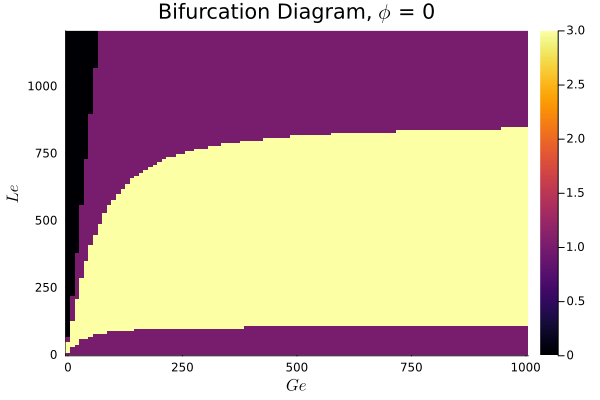

In [9]:
bifMap = ones(121, 101)
p = (μ = 0.02, D = 2, kₘ = 0.18, kₑ = 18.8, kₗ = 6e4, γₘ = 0.48, γₑ = 0.03, γₗ = 0.02, kpc = 30, 
    pₚ = 0.127, Φₘ = 0, K_G = 2.6, nₕ = 1.3, ξ₂ = 0.05, ξ₃ = 0.01, ξ₁₂₃ = 163, ρₘₐₓ = 1.3, 
    Kₐ = 2.92e6, κₗ = 680, Φg = 0.35, κg = 1, κₘ = 7e5)
for i ∈ 0:10:1200
    global Le = copy(i)
    for j ∈ 0:10:1000
        global Ge = copy(j)
        bifMap[Int(i/10 + 1), Int(j/10 + 1)] = size(find_zeros(steady, 0, 1e8), 1)
    end
end

heatmap(0:10:1000, 0:10:1200, bifMap, xlabel = L"$Ge$", ylabel = L"$Le$", title = L"Bifurcation Diagram, $\phi$ = %$(p.Φₘ)")

<div class="alert alert-block alert-success">

> **Now, lets look at normalized histograms for the number of lactose molecules. I'll let the system evolve for less time, and fix $Le$ to 300** (instead of 1000 to agree better with my bifurcation diagram) **while varying $Ge$.**
>
> **Notice how the _lac_ operon remain uninduced when $Ge \ge 100\mu\mathrm{M}$** (some counts close to lactose = 0), **but as we decrease $Ge$, it is induced, increasing the molecule counts for lactose** 

</div>

In [10]:
function SSA_tau(u₀, p, Le, Ge, leap = 0.5, steps = 2000, cycles = 100)
    # leap   -> Size of leaping steps
    # steps  -> Number of leaps per trajectory
    # cycles -> Number of trajectories iterated over
    
        ###### Fix model parameters ######
    N_M0, N_E0, N_L0 = u₀     # Initial number of molecules
    #-------------
    p_c(Ge) = p.K_G^p.nₕ / (p.K_G^p.nₕ + Ge^p.nₕ)
    P_D(Ge) = (p.pₚ*(1 + p_c(Ge) * (p.kpc - 1))) / (1 + p.pₚ * p_c(Ge) * (p.kpc - 1))
    ρ(A) = p.ρₘₐₓ * (p.Kₐ / (p.Kₐ + A))^4
    P_R(A) = 1 / (1 + ρ(A) + ((p.ξ₁₂₃ * ρ(A)) / ((1 + p.ξ₂ * ρ(A)) * (1 + p.ξ₃ * ρ(A)))))
    β_L(Le) = Le / (p.κₗ + Le)
    β_G(Ge) = 1 - p.Φg * Ge / (p.κg + Ge)
    M_(L) = L / (p.κₘ + L)
    #-------------
    

    
    # Set up holder arrays
    T = collect(0:steps)*leap
    N_M = zeros(Int64, cycles, steps+1)
    N_E = zeros(Int64, cycles, steps+1)
    N_L = zeros(Int64, cycles, steps+1)
    
    # Store initial conditions
    N_M[:,1] .= N_M0
    N_E[:,1] .= N_E0
    N_L[:,1] .= N_L0

    ###### Main Code Loop ######
    for i ∈ 1:cycles
        for j ∈ 1:steps
            # Calculate updated reaction rates
            A = N_L[i,j]
            Q = N_E[i,j]
            B = N_E[i,j]/4
    
            R1 = p.D * p.kₘ * P_D(Ge) * P_R(A)
            R2 = p.γₘ * N_M[i,j]
            R3 = p.kₑ * N_M[i,j]
            R4 = p.γₑ * N_E[i,j]
            R5 = p.kₗ * β_L(Le) * β_G(Ge) * Q
            R6 = 2 * p.Φₘ * M_(N_L[i,j]) * B
            R7 = p.γₗ * N_L[i,j]        
            
            # Calculate number of reactions by type
            u1 = rand()
            u2 = rand()
            u3 = rand()
            u4 = rand()
            u5 = rand()
            u6 = rand()
            u7 = rand()
            
            N1 = quantile(Poisson(R1*leap), u1)
            N2 = quantile(Poisson(R2*leap), u2)
            N3 = quantile(Poisson(R3*leap), u3)
            N4 = quantile(Poisson(R4*leap), u4)
            N5 = quantile(Poisson(R5*leap), u5)
            N6 = quantile(Poisson(R6*leap), u6)
            N7 = quantile(Poisson(R7*leap), u7)
            
            # Apply limits to prevent negative population
            Limit2 = N_M[i,j]
            Limit4 = N_E[i,j]
            Limit6 = N_L[i,j]
            Limit7 = N_L[i,j]
            
            N2 = min(N2, Limit2)
            N4 = min(N4, Limit4)
            N6 = min(N6, Limit6)
            N7 = min(N7, Limit7)
            
            # Update populations
            N_M[i,j+1] = N_M[i,j] + N1 - N2
            N_E[i,j+1] = N_E[i,j] + N3 - N4
            N_L[i,j+1] = N_L[i,j] + N5 - N6 - N7
        end
    end
    return N_M, N_E, N_L
end;

In [46]:
function hist_lactose(N_L, Le, Ge, leap = 0.5, steps = 2000, cycles = 100)
    time = leap*steps
    N_L_time = zeros(cycles)
    
    for i ∈ 1:cycles
        for j ∈ 2:steps
            if T[j] >= time && T[j-1] < time
                N_L_time[i] = N_L[i,j]
            end
        end
        # If trajectory doesn't span far enough take latest observation
        if T[steps] < time
            N_L_time[i] = N_L[i, steps]
        end
    end
    
    histogram(N_L_time, normalize=:probability, bins = 50, label = "Lactose", color = :green, xlim=(0, Inf)) #ylim=(-Inf, 1), yaxis=:log10
    xlabel!("Lactose count per bacterium")
    ylabel!("Density")
    title!(L"$Ge$ = %$Ge $\mu M$")
end;

In [47]:
leap, steps, cycles = 0.5, 2000, 300
Le = 300

Ge = 1000
N_M, N_E, N_L_1000 = SSA_tau(u₀, p, Le, Ge, leap, steps, cycles)
p1 = hist_lactose(N_L_1000, Le, Ge, leap, steps, cycles)

Ge = 400
N_M, N_E, N_L_400 = SSA_tau(u₀, p, Le, Ge, leap, steps, cycles)
p2 = hist_lactose(N_L_400, Le, Ge, leap, steps, cycles)

Ge = 200
N_M, N_E, N_L_200 = SSA_tau(u₀, p, Le, Ge, leap, steps, cycles)
p3 = hist_lactose(N_L_200, Le, Ge, leap, steps, cycles)

Ge = 100
N_M, N_E, N_L_100 = SSA_tau(u₀, p, Le, Ge, leap, steps, cycles)
p4 = hist_lactose(N_L_100, Le, Ge, leap, steps, cycles)

Ge = 40
N_M, N_E, N_L_40 = SSA_tau(u₀, p, Le, Ge, leap, steps, cycles)
p5 = hist_lactose(N_L_40, Le, Ge, leap, steps, cycles)

Ge = 20
N_M, N_E, N_L_20 = SSA_tau(u₀, p, Le, Ge, leap, steps, cycles)
p6 = hist_lactose(N_L_20, Le, Ge, leap, steps, cycles)

Ge = 10
N_M, N_E, N_L_10 = SSA_tau(u₀, p, Le, Ge, leap, steps, cycles)
p7 = hist_lactose(N_L_10, Le, Ge, leap, steps, cycles)

Ge = 4
N_M, N_E, N_L_4 = SSA_tau(u₀, p, Le, Ge, leap, steps, cycles)
p8 = hist_lactose(N_L_4, Le, Ge, leap, steps, cycles);

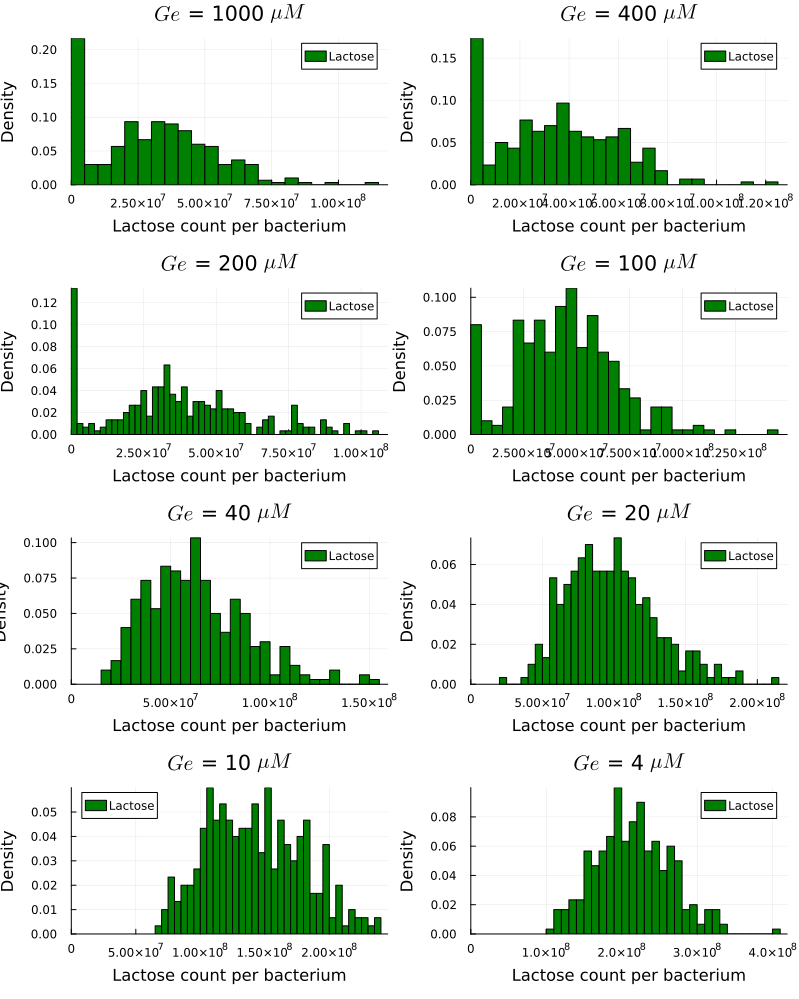

In [51]:
plot(p1, p2, p3, p4, p5, p6, p7, p8, layout = (4, 2))
plot!(size=(800,1000))